In [1]:
from utllity_functions import *
import torch
import torch.nn as nn
import numpy as np
import torchvision
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation, PillowWriter
import os
from torch.utils.data import Dataset
from PIL import Image
from typing import  Tuple
from tqdm import tqdm
import torch.nn.functional as F
from torch.utils.data import DataLoader
from IPython.display import HTML

In [2]:
def plot_sample(x_gen_store,n_sample,nrows,save_dir, fn,  w, save=False):
    ncols = n_sample//nrows
    sx_gen_store = np.moveaxis(x_gen_store,2,4)                               # change to Numpy image format (h,w,channels) vs (channels,h,w)
    nsx_gen_store = norm_all(sx_gen_store, sx_gen_store.shape[0], n_sample)   # unity norm to put in range [0,1] for np.imshow

    # create gif of images evolving over time, based on x_gen_store
    fig, axs = plt.subplots(nrows=nrows, ncols=ncols, sharex=True, sharey=True,figsize=(ncols,nrows))
    def animate_diff(i, store):
        print(f'gif animating frame {i} of {store.shape[0]}', end='\r')
        plots = []
        for row in range(nrows):
            for col in range(ncols):
                axs[row, col].clear()
                axs[row, col].set_xticks([])
                axs[row, col].set_yticks([])
                plots.append(axs[row, col].imshow(store[i,(row*ncols)+col]))
        return plots
    ani = FuncAnimation(fig, animate_diff, fargs=[nsx_gen_store],  interval=200, blit=False, repeat=True, frames=nsx_gen_store.shape[0])
    plt.close()
    if save:
        ani.save(save_dir + f"{fn}_w{w}.gif", dpi=100, writer=PillowWriter(fps=5))
        print('saved gif at ' + save_dir + f"{fn}_w{w}.gif")
    return ani

# Diffusion Model Hyperparameters

In [3]:
# hyperparameters
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
# diffusion hyperparameters
timesteps = 1000
beta1 = 1e-4
beta2 = 0.02

# network hyperparameters
device = torch.device("cuda:0" if torch.cuda.is_available() else torch.device('cpu'))
n_feat = 64
n_cfeat = 5 
height = 32 # 32x32 image
save_dir = './weights/'

# training hyperparameters
batch_size = 100
n_epoch = 500
lrate=1e-3

# Construct DDPM noise schedule

In [4]:

b_t = (beta2 - beta1) * torch.linspace(0, 1, timesteps + 1, device=device) + beta1
a_t = 1 - b_t
ab_t = torch.cumsum(a_t.log(), dim=0).exp()
ab_t[0] = 1

# Construct Model

In [5]:

nn_model = ContextUnet(in_channels=3, n_feat=n_feat, n_cfeat=n_cfeat, height=height).to(device)

# Dataset and Data Loader

In [6]:
transform = transforms.Compose([transforms.Resize(32)\
                                ,transforms.ToTensor(),\
                                transforms.Normalize((0.5,), (0.5,))])  # range [-1,1]])
                                # transforms.Grayscale()\



In [8]:
data_path = './data'
train_dataset = torchvision.datasets.ImageFolder(
    root=data_path,
    transform=transform
)
train_loader = DataLoader(
    train_dataset,
    batch_size=64,
    num_workers=1,
    shuffle=True
)

In [9]:
def to_device(data, device):
    if isinstance(data, (list,tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)
class DeviceDataLoader():
    """Wrap a dataloader to move data to a device"""
    def __init__(self, dl, device):
        self.dl = dl
        self.device = device

    def __iter__(self):
        """Yield a batch of data after moving it to device"""
        for b in self.dl:
            yield to_device(b, self.device)

    def __len__(self):
        """Number of batches"""
        return len(self.dl)

In [10]:
device

device(type='cuda', index=0)

In [11]:
dataloader = DeviceDataLoader(train_loader, device)

In [12]:
# load dataset and construct optimizer
optim = torch.optim.Adam(nn_model.parameters(), lr=lrate)

# Load Saved Model

In [13]:
load_from_checkpoint = True
model_epoch = 'model_499'
if load_from_checkpoint:
    checkpoint = torch.load(f'./weights/{model_epoch}.pth',map_location=device)
    nn_model.load_state_dict(checkpoint)

In [14]:
# helper function: perturbs an image to a specified noise level
def perturb_input(x, t, noise):
    return ab_t.sqrt()[t, None, None, None] * x + (1 - ab_t[t, None, None, None]) * noise

# Training

In [ ]:
# # training without context

# # set into train mode
# nn_model.train()

# for ep in range(n_epoch):
#     print(f'epoch {ep}')

#     # linearly decay learning rate
#     optim.param_groups[0]['lr'] = lrate*(1-ep/n_epoch)

#     pbar = tqdm(dataloader, mininterval=2 )
#     for x, _ in pbar:   # x: images
#         optim.zero_grad()
#         x = x.to(device)

#         # perturb data
#         noise = torch.randn_like(x)
#         t = torch.randint(1, timesteps + 1, (x.shape[0],)).to(device)
#         x_pert = perturb_input(x, t, noise)

#         # use network to recover noise
#         pred_noise = nn_model(x_pert, t / timesteps)

#         # loss is mean squared error between the predicted and true noise
#         loss = F.mse_loss(pred_noise, noise)
#         loss.backward()

#         optim.step()

#     # save model periodically
#     if ep%10==0 or ep == int(n_epoch-1):
#         if not os.path.exists(save_dir):
#             os.mkdir(save_dir)
#         torch.save(nn_model.state_dict(), save_dir + f"model_{ep}.pth")
#         print('saved model at ' + save_dir + f"model_{ep}.pth")

# Sampling

In [15]:
# remove predicted noise at time t -> add some noise back
def denoise_add_noise(x, t, pred_noise, z=None):
    if z is None:
        z = torch.randn_like(x)
    noise = b_t.sqrt()[t] * z
    mean = (x - pred_noise * ((1 - a_t[t]) / (1 - ab_t[t]).sqrt())) / a_t[t].sqrt()
    return mean + noise

In [16]:
# sample using  ddpm
@torch.no_grad()
def sample_ddpm(n_sample, save_rate=20):
    # x_T ~ N(0, 1), sample initial noise
    samples = torch.randn(n_sample, 3, height, height).to(device)

    # array to keep track of generated steps for plotting
    intermediate = []
    for i in range(timesteps, 0, -1):
        print(f'sampling timestep {i:3d}', end='\r')

        # reshape time tensor
        t = torch.tensor([i / timesteps])[:, None, None, None].to(device)

        # sample some random noise to inject back in. For i = 1, don't add back in noise
        z = torch.randn_like(samples) if i > 1 else 0

        eps = nn_model(samples, t)    # predict noise e_(x_t,t)
        samples = denoise_add_noise(samples, i, eps, z)
        if i % save_rate ==0 or i==timesteps or i<8:
            intermediate.append(samples.detach().cpu().numpy())

    intermediate = np.stack(intermediate)
    return samples, intermediate

In [17]:
# visualize samples
plt.clf()
samples, intermediate_ddpm = sample_ddpm(32)
animation_ddpm = plot_sample(intermediate_ddpm,32,4,save_dir, "ani_run", None, save=False)
HTML(animation_ddpm.to_jshtml())

Animation size has reached 21041448 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


<Figure size 640x480 with 0 Axes>

In [18]:
intermediate_ddpm.shape

(57, 32, 3, 32, 32)

In [24]:
test_img = samples[20].detach().cpu().numpy()

In [25]:
test_img.shape

(3, 32, 32)

In [26]:
test_img = np.moveaxis(test_img,0,2)   # change to Numpy image format (h,w,channels) vs (channels,h,w)

print(test_img.shape)
smpl = np.zeros_like(test_img)
smpl = unorm(test_img)
smpl.shape
# test_img = norm_all(test_img, test_img.shape[0])   # unity norm to put in range [0,1] for np.imshow

(32, 32, 3)


(32, 32, 3)

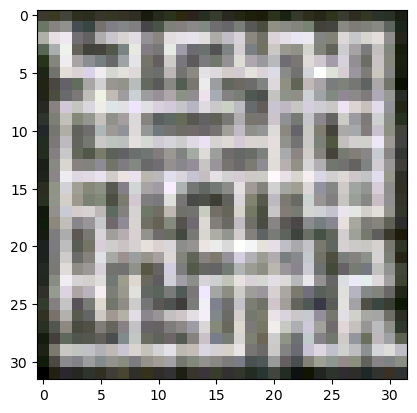

In [27]:
plt.imshow(smpl)
plt.show()

In [92]:
smpl.shape

(32, 32, 3)

# Acknowledgments

This code is modified from, https://github.com/cloneofsimo/minDiffusion and https://www.coursera.org/learn/how-diffusion-models-work-project

Diffusion model is based on [Denoising Diffusion Probabilistic Models](https://arxiv.org/abs/2006.11239) and [Denoising Diffusion Implicit Models](https://arxiv.org/abs/2010.02502)

Dataset [Maze Dataset](https://www.kaggle.com/datasets/emadehsan/rectangular-maze-kruskals-spanning-tree-algorithm)